In [1]:
import sys
sys.executable

'/Users/benjaminlevy/Desktop/Benjamin/School/20/classes/stat185/project/beta-vae-env/bin/python'

In [2]:
%load_ext autoreload
%autoreload 2

# Testing $\beta$-VAE model

In [313]:
import string
from IPython.display import display
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image

import torch
from torch.utils.data import DataLoader
from torchvision.datasets import EMNIST
from torchvision import transforms

from betavae import config, utils, plotting, models, training, datasets

Loading EMNIST

In [83]:
emnist_dir = config.data / 'emnist'
emnist_dir.mkdir(exist_ok=True, parents=True)

transform = transforms.Compose([
    # you can add other transformations in this list
    transforms.ToTensor()
])

dataset_train = EMNIST(str(emnist_dir),
                       split='letters',
                       transform=transform,
                       download=True,
                       train=True)
dataset_test = EMNIST(str(emnist_dir),
                      split='letters',
                      transform=transform,
                      download=True,
                      train=False)

Displaying some examples

In [142]:
chars = dataset_train.classes
idxs = np.random.choice(len(dataset_train), replace=False, size=12)
displaydata = [dataset_train[idx] for idx in idxs]
images = [d[0] for d in displaydata]
labs = [chars[d[1]-1] for d in displaydata]

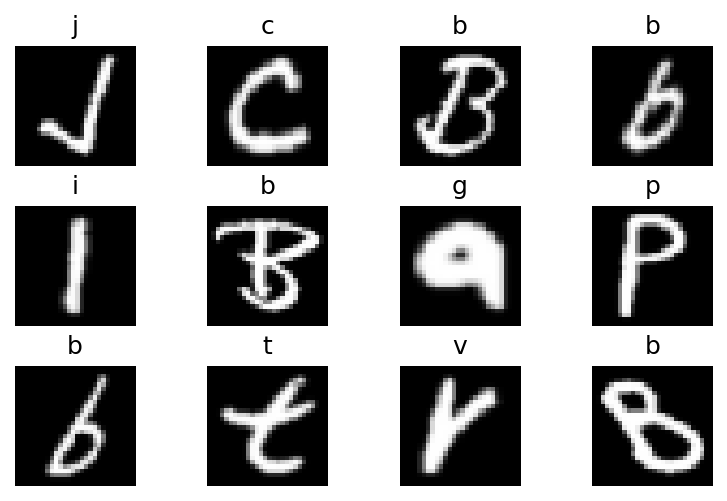

In [143]:
plotting.display_images(images, labels=labs)

subsetting to only A-E

Building a $\beta$-VAE

In [238]:
model = models.BetaVAE((1, 28, 28),
                       encoder_layers=6,
                       decoder_layers=6,
                       dropout=0.1,
                       latent_dim=8,
                       beta=1)

Training

In [254]:
training.train_model(model,
                     dataset_train,
                     dataset_test,
                     num_epochs=20,
                     log_steps=500,
                     eval_steps=500,
                     batch_size=256,
                     keep_letters='az',
                     lr=1e-3);

Training for 20 epochs.
Epoch 0



Evaluating



Eval loss: 254.6251
Epoch 1



Evaluating



Eval loss: 239.2650
Epoch 2



Evaluating



Eval loss: 236.9906
Epoch 3



Evaluating



Eval loss: 234.3768
Epoch 4



Evaluating



Eval loss: 231.4388
Epoch 5



Evaluating



Eval loss: 231.2519
Epoch 6



Evaluating



Eval loss: 228.7020
Epoch 7



Evaluating



Eval loss: 228.7855
Epoch 8



Evaluating



Eval loss: 232.9735
Epoch 9



Evaluating



Eval loss: 232.5931
Epoch 10



Evaluating



Eval loss: 228.9016
Epoch 11



Evaluating



Eval loss: 228.8899
Epoch 12



Evaluating



Eval loss: 228.6930
Epoch 13



Evaluating



Eval loss: 228.6873
Epoch 14



Evaluating



Eval loss: 227.5192
Epoch 15



Evaluating



Eval loss: 224.5585
Epoch 16



Evaluating



Eval loss: 228.3724
Epoch 17



Evaluating



Eval loss: 225.6442
Epoch 18



Evaluating



Eval loss: 228.2764
Epoch 19



Evaluating



Eval loss: 225.6103
Training done. Doing final evaluation
Evaluating



Eval loss: 225.6540


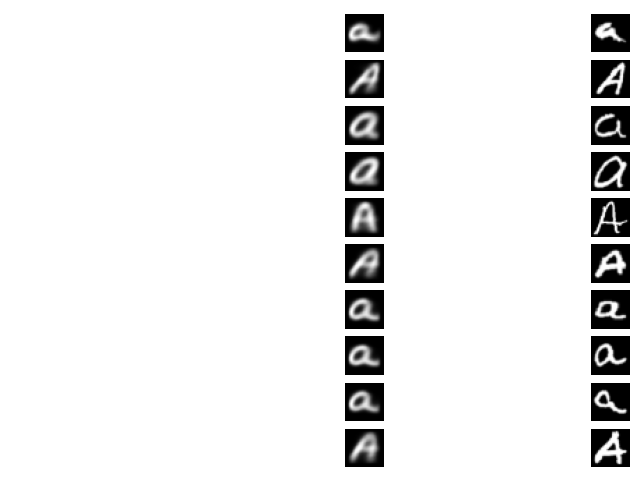

In [255]:
model.eval()
sampler = datasets.FilterSampler(dataset_test.targets, 'az', dataset_test.classes)
loader_eval = DataLoader(dataset_test, batch_size=64, sampler=sampler)
inputs, labels = next(iter(loader_eval))
with torch.no_grad():
    preds = model(inputs)[0]
plotting.display_preds_trg(preds[:10], inputs[:10], labels=None)

Exploring latent space

In [256]:
embeddings = []
labels = []
for inputs, labs in loader_eval:
    with torch.no_grad():
        z = model.embed(inputs)
    embeddings.append(z)
    labels.append(labs)
embeddings = torch.cat(embeddings, dim=0)
labels = torch.cat(labels, dim=0)

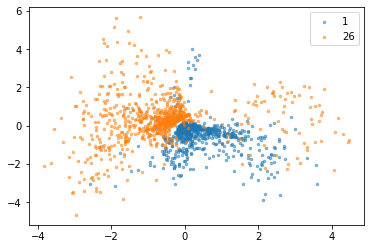

In [270]:
for cls in set(labels.tolist()):
    idxs = labels == cls
    plt.scatter(embeddings[idxs, 3],
                embeddings[idxs, 7],
                label=cls,
                alpha=0.5,
                s=6)
plt.legend()

Sampling from the latent space

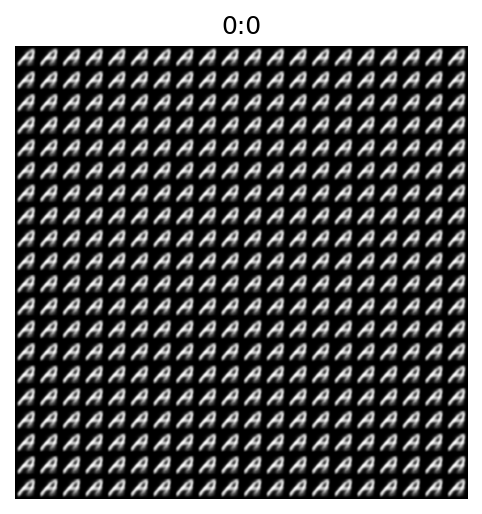

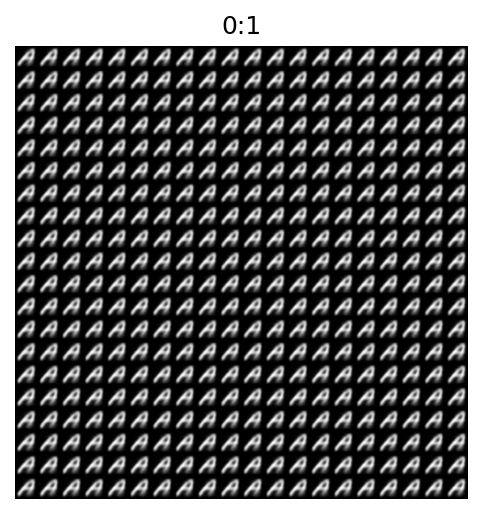

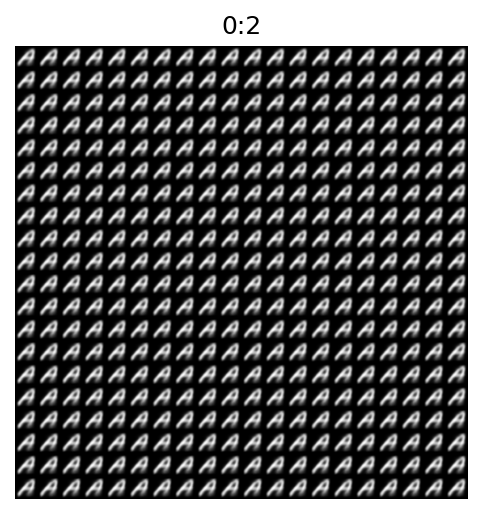

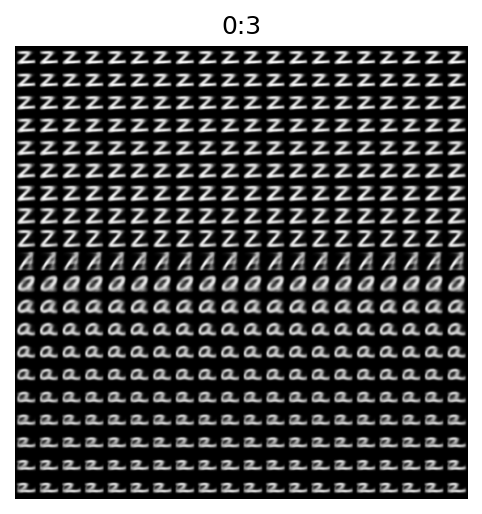

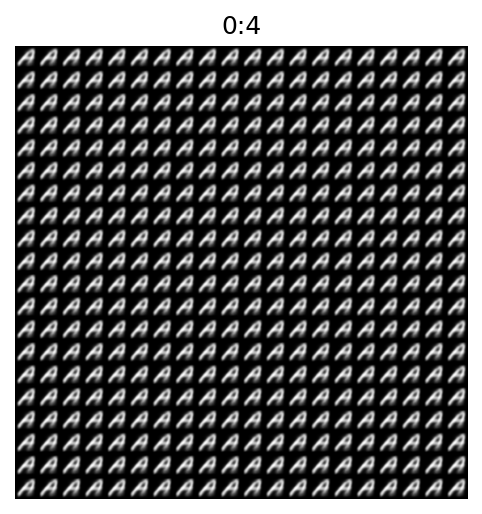

...

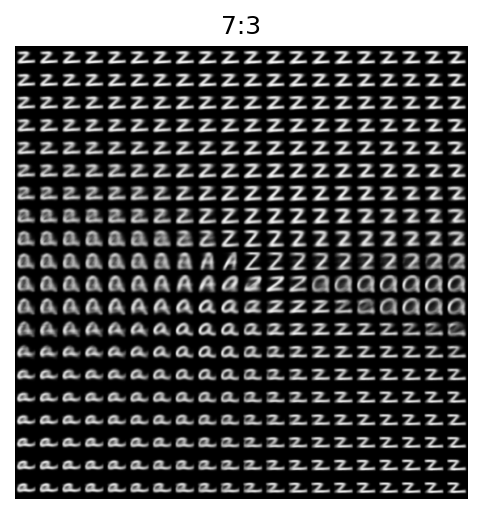

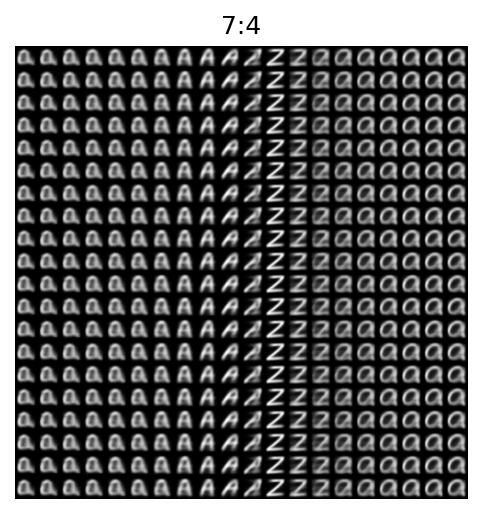

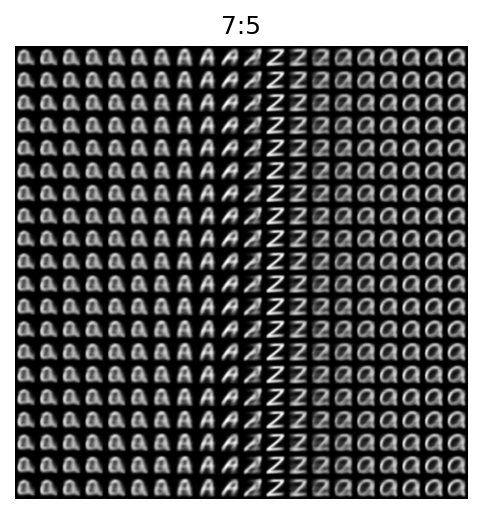

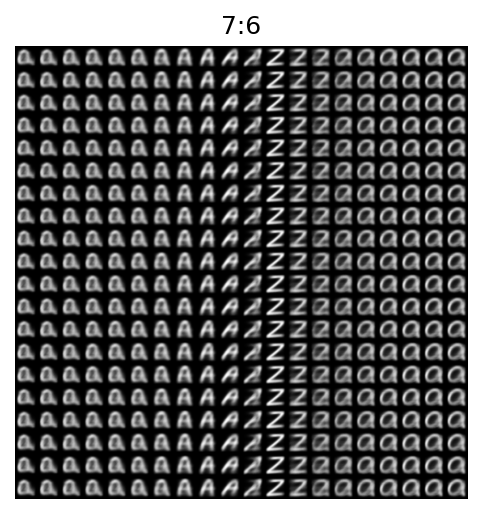

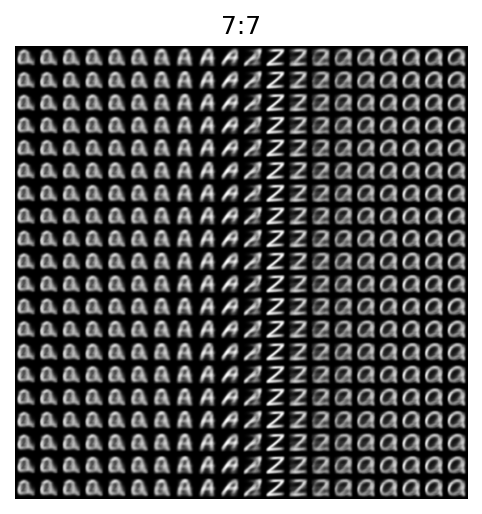

In [311]:
for i in range(8):
    for j in range(8):
        plt.figure(dpi=150)
        plotting.traverse_latent_space(model, i, j, 8,
                                       nrows=20, ncols=20)
        plt.title(f'{i}:{j}')
        plt.show()

Testing different $\beta$

Training for 15 epochs.
Epoch 0



Evaluating



Eval loss: 314.2530
Epoch 1



Evaluating



Eval loss: 287.7866
Epoch 2



Evaluating



Eval loss: 286.1682
Epoch 3



Evaluating



Eval loss: 281.9717
Epoch 4



Evaluating



Eval loss: 269.9379
Epoch 5



Evaluating



Eval loss: 263.5071
Epoch 6



Evaluating



Eval loss: 260.5235
Epoch 7



Evaluating



Eval loss: 257.3352
Epoch 8



Evaluating



Eval loss: 254.8857
Epoch 9



Evaluating



Eval loss: 253.7217
Epoch 10



Evaluating



Eval loss: 252.9047
Epoch 11



Evaluating



Eval loss: 252.6097
Epoch 12



Evaluating



Eval loss: 251.5527
Epoch 13



Evaluating



Eval loss: 251.0893
Epoch 14



Evaluating



Eval loss: 250.5424
Training done. Doing final evaluation
Evaluating



Eval loss: 250.4766


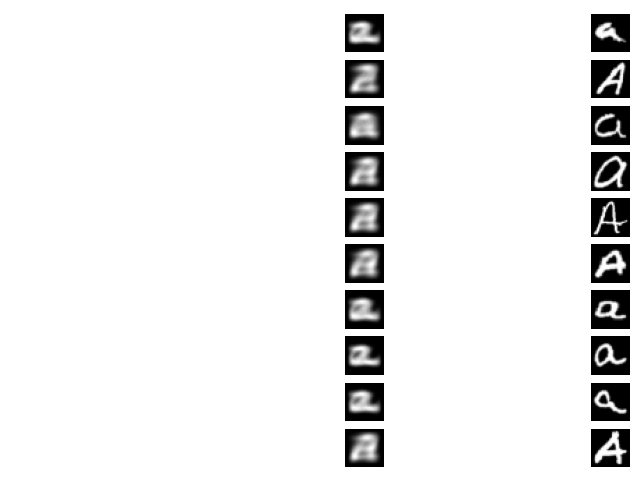

Training for 15 epochs.
Epoch 0



Evaluating



Eval loss: 355.9427
Epoch 1



Evaluating



Eval loss: 288.2056
Epoch 2



Evaluating



Eval loss: 286.3532
Epoch 3



Evaluating



Eval loss: 286.1785
Epoch 4



Evaluating



Eval loss: 285.7692
Epoch 5



Evaluating



Eval loss: 285.5117
Epoch 6



Evaluating



Eval loss: 285.4594
Epoch 7



Evaluating



Eval loss: 285.0704
Epoch 8



Evaluating



Eval loss: 284.3093
Epoch 9



Evaluating



Eval loss: 274.8315
Epoch 10



Evaluating



Eval loss: 268.2113
Epoch 11



Evaluating



Eval loss: 265.8613
Epoch 12



Evaluating



Eval loss: 262.0004
Epoch 13



Evaluating



Eval loss: 260.4998
Epoch 14



Evaluating



Eval loss: 258.6061
Training done. Doing final evaluation
Evaluating



Eval loss: 258.0924


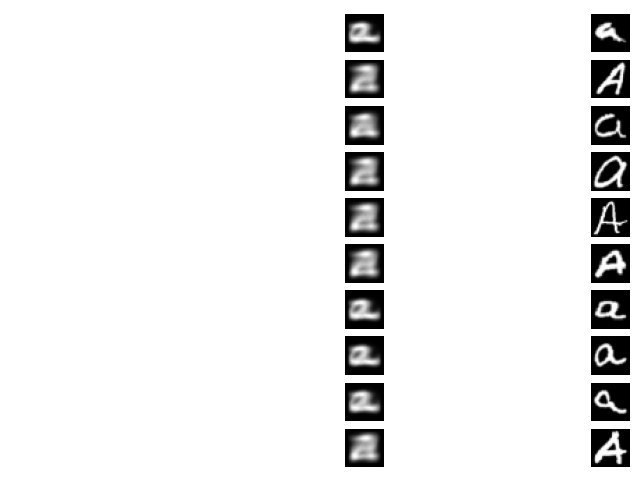

Training for 15 epochs.
Epoch 0



Evaluating



Eval loss: 321.7731
Epoch 1



Evaluating



Eval loss: 287.9245
Epoch 2



Evaluating



Eval loss: 286.6091
Epoch 3



Evaluating



Eval loss: 286.0212
Epoch 4



Evaluating



Eval loss: 286.0298
Epoch 5



Evaluating



Eval loss: 285.9232
Epoch 6



Evaluating



Eval loss: 285.7627
Epoch 7



Evaluating



Eval loss: 285.6075
Epoch 8



Evaluating



Eval loss: 285.5589
Epoch 9



Evaluating



Eval loss: 285.3815
Epoch 10



Evaluating



Eval loss: 285.3928
Epoch 11



Evaluating



Eval loss: 285.2685
Epoch 12



Evaluating



Eval loss: 285.2596
Epoch 13



Evaluating



Eval loss: 285.2916
Epoch 14



Evaluating



Eval loss: 285.1197
Training done. Doing final evaluation
Evaluating



Eval loss: 285.2299


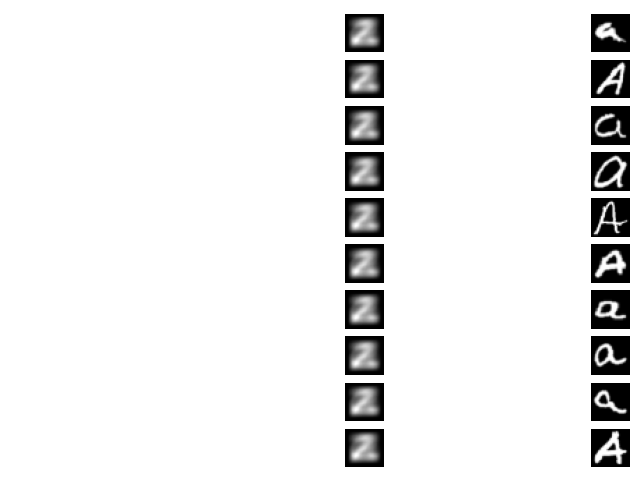

In [346]:
betas = [0, 1, 5]
model_list = []
sampler = datasets.FilterSampler(dataset_test.targets, 'az', dataset_test.classes)
loader_eval = DataLoader(dataset_test, batch_size=64, sampler=sampler)
    
for beta in betas:
    model = models.BetaVAE((1, 28, 28),
                           encoder_layers=6,
                           decoder_layers=6,
                           dropout=0.1,
                           latent_dim=2,
                           beta=beta)
    training.train_model(model,
                     dataset_train,
                     dataset_test,
                     num_epochs=15,
                     log_steps=500,
                     eval_steps=500,
                     batch_size=256,
                     keep_letters='az',
                     lr=1e-3)
    model_list.append(model)
    
    model.eval()
    inputs, labels = next(iter(loader_eval))
    with torch.no_grad():
        preds = model(inputs)[0]
    plotting.display_preds_trg(preds[:10], inputs[:10], labels=None)
    plt.show()

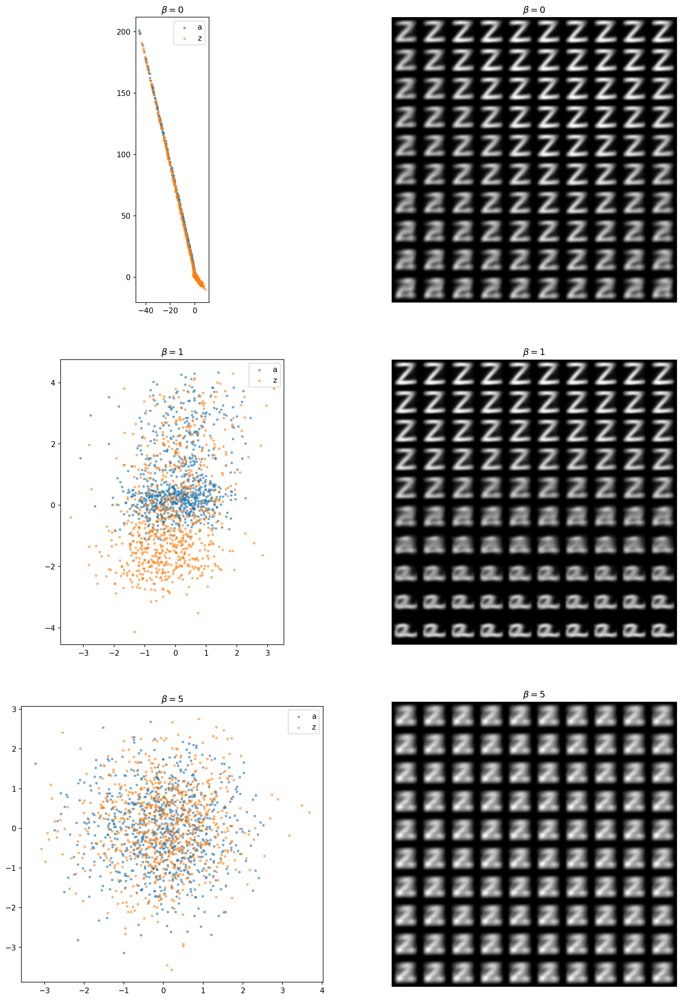

In [347]:
fig, axs = plt.subplots(len(model_list), 2,
                        figsize=(16, 8 * len(model_list)),
                        dpi=150)
for i, (model, beta) in enumerate(zip(model_list, betas)):
    plotting.plot_latent_space(model, loader_eval, ax=axs[i, 0],
                               label_dict={1: 'a', 26: 'z'})
    plotting.traverse_latent_space(model, 0, 1, 2, ax=axs[i, 1])
    for j in [0, 1]:
        axs[i, j].set_title(r'$\beta={0}$'.format(beta))
        axs[i, j].set(adjustable='box', aspect='equal')